In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import geopandas as gpd
import folium
from folium.plugins import FastMarkerCluster
from shapely.geometry import Point,Polygon

In [2]:
df=pd.read_csv("/Users/danielbeltsazar/Work/ZebraX/New Dataset/New Dataset/Regression/Uber and Lyft Dataset/uberlyft_price_reg.csv")
df.head()

,id,timestamp,hour,day,month,datetime,timezone,source,destination,cab_type,...,precipIntensityMax,uvIndexTime,temperatureMin,temperatureMinTime,temperatureMax,temperatureMaxTime,apparentTemperatureMin,apparentTemperatureMinTime,apparentTemperatureMax,apparentTemperatureMaxTime
0,424553bb-7174-41ea-aeb4-fe06d4f4b9d7,1.544953e+09,9,16,12,2018-12-16 09:30:07,America/New_York,Haymarket Square,North Station,Lyft,...,0.1276,1544979600,39.89,1545012000,43.68,1544968800,33.73,1545012000,38.07,1544958000
1,4bd23055-6827-41c6-b23b-3c491f24e74d,1.543284e+09,2,27,11,2018-11-27 02:00:23,America/New_York,Haymarket Square,North Station,Lyft,...,0.1300,1543251600,40.49,1543233600,47.30,1543251600,36.20,1543291200,43.92,1543251600
2,981a3613-77af-4620-a42a-0c0866077d1e,1.543367e+09,1,28,11,2018-11-28 01:00:22,America/New_York,Haymarket Square,North Station,Lyft,...,0.1064,1543338000,35.36,1543377600,47.55,1543320000,31.04,1543377600,44.12,1543320000
3,c2d88af2-d278-4bfd-a8d0-29ca77cc5512,1.543554e+09,4,30,11,2018-11-30 04:53:02,America/New_York,Haymarket Square,North Station,Lyft,...,0.0000,1543507200,34.67,1543550400,45.03,1543510800,30.30,1543550400,38.53,1543510800
4,e0126e1f-8ca9-4f2e-82b3-50505a09db9a,1.543463e+09,3,29,11,2018-11-29 03:49:20,America/New_York,Haymarket Square,North Station,Lyft,...,0.0001,1543420800,33.10,1543402800,42.18,1543420800,29.11,1543392000,35.75,1543420800


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 637976 entries, 0 to 637975
Data columns (total 57 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   id                           637976 non-null  object 
 1   timestamp                    637976 non-null  float64
 2   hour                         637976 non-null  int64  
 3   day                          637976 non-null  int64  
 4   month                        637976 non-null  int64  
 5   datetime                     637976 non-null  object 
 6   timezone                     637976 non-null  object 
 7   source                       637976 non-null  object 
 8   destination                  637976 non-null  object 
 9   cab_type                     637976 non-null  object 
 10  product_id                   637976 non-null  object 
 11  name                         637976 non-null  object 
 12  price                        637976 non-null  float64
 13 

In [4]:
df['datetime']=pd.to_datetime(df['datetime'])

In [5]:
df.isnull().sum().sum()

0

In [6]:
df['visibility'].head()

0    10.000
1     4.786
2    10.000
3    10.000
4    10.000
Name: visibility, dtype: float64

In [7]:
df = df.drop(['visibility.1'],axis=1)

In [8]:
df.shape

(637976, 56)

In [9]:
df = df.drop_duplicates(keep='first')

In [10]:
df.shape

(637976, 56)

# EDA and Visualization

## 1. Time Analysis 

### --Month Data--

In [11]:
def plot_bar(groupby_column):
    df1 =df.groupby(groupby_column).size().reset_index(name="counts")
    fig1 = px.bar(data_frame=df1, x=groupby_column, y="counts", color=groupby_column, barmode="group")
    print(df1)
    fig1.show(renderer='png')

   month  counts
0     11  263771
1     12  374205


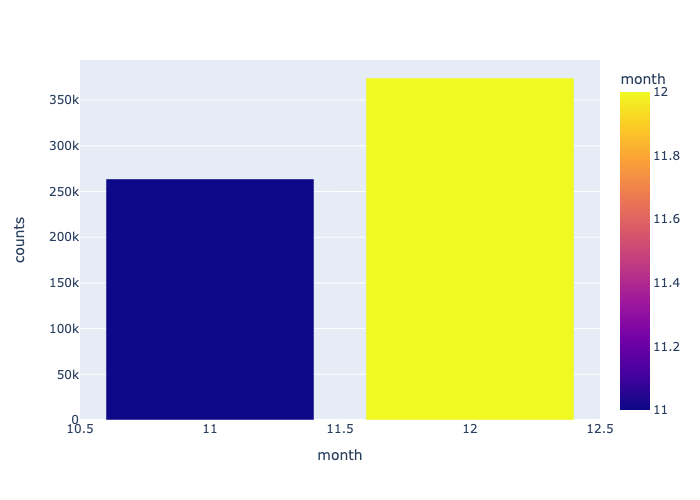

In [12]:
plot_bar('month')

### It appears that we only have november and december in our month data. It means the data is only recorded or taken in november and december with december data dominating.

### --Day Data--

    day  counts
0     1   41680
1     2   41298
2     3   41323
3     4   11627
4     9    1529
5    10    2534
6    13   35496
7    14   41344
8    15   41332
9    16   41359
10   17   41354
11   18   33329
12   26   29028
13   27   70135
14   28   67842
15   29   55222
16   30   41544


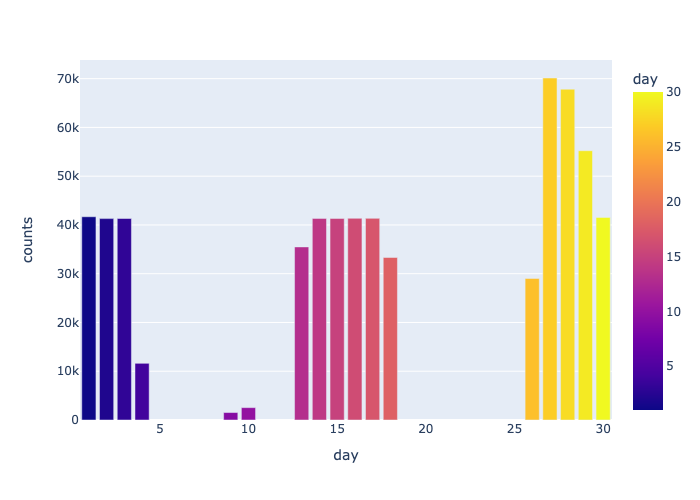

In [13]:
plot_bar('day')

### It seems we have many gaps in our 'day' data. For example we don't have data from 18th day until 25th day in each month.

### --Hour Data--

    hour  counts
0      0   29872
1      1   26310
2      2   26323
3      3   25530
4      4   26125
5      5   22995
6      6   25147
7      7   22930
8      8   22337
9      9   26673
10    10   27918
11    11   27946
12    12   28017
13    13   27977
14    14   27976
15    15   27868
16    16   27972
17    17   28075
18    18   27958
19    19   25410
20    20   24620
21    21   25549
22    22   27093
23    23   29355


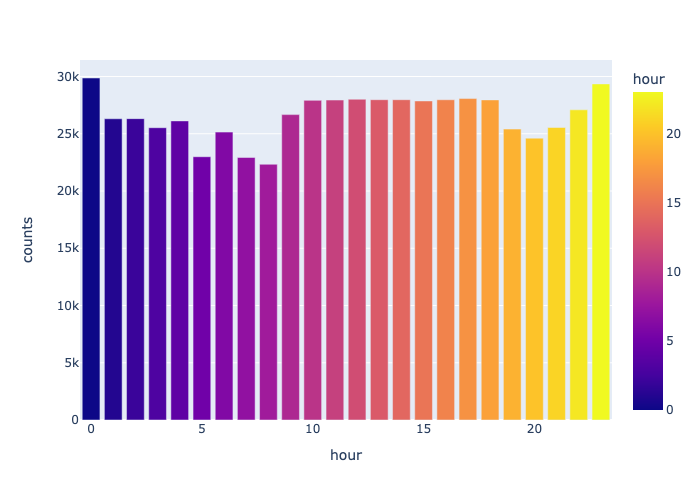

In [14]:
plot_bar('hour')

### It seems we have almost 24 hours recorded data

## 2. Source and Destination Analysis

                     source  counts
0                  Back Bay   53201
1               Beacon Hill   52841
2         Boston University   53172
3                    Fenway   53166
4        Financial District   54197
5          Haymarket Square   53147
6                 North End   53171
7             North Station   52576
8   Northeastern University   53164
9             South Station   53160
10         Theatre District   53201
11                 West End   52980


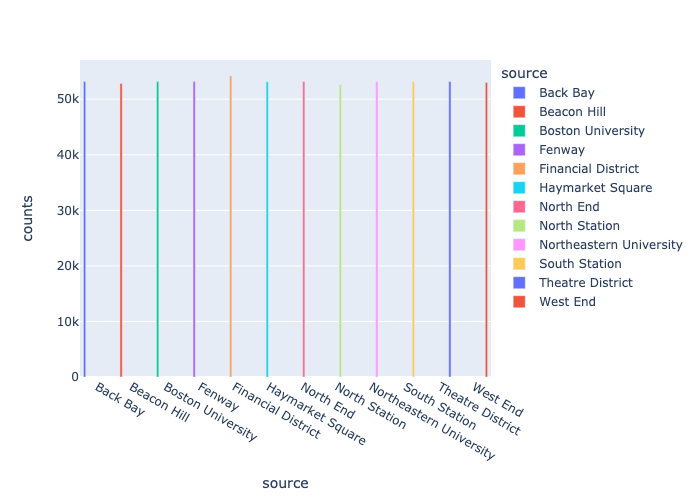

In [15]:
plot_bar('source')

### It seems that all sources are almost equal in number. There are about 50k data in each source feature (Back Bay, Beacon Hill, Boston University, etc)

                destination  counts
0                  Back Bay   53190
1               Beacon Hill   52840
2         Boston University   53171
3                    Fenway   53166
4        Financial District   54192
5          Haymarket Square   53171
6                 North End   53164
7             North Station   52577
8   Northeastern University   53165
9             South Station   53159
10         Theatre District   53189
11                 West End   52992


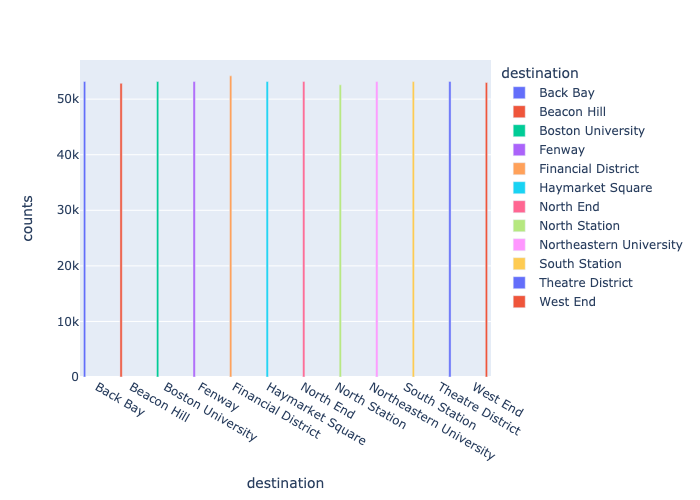

In [16]:
plot_bar('destination')

### Same with source feature, there are about 50k data in each destination feature (Back Bay, Beacon Hill, Boston University, etc)

## Cab Type Analysis

  cab_type  counts
0     Lyft  307408
1     Uber  330568


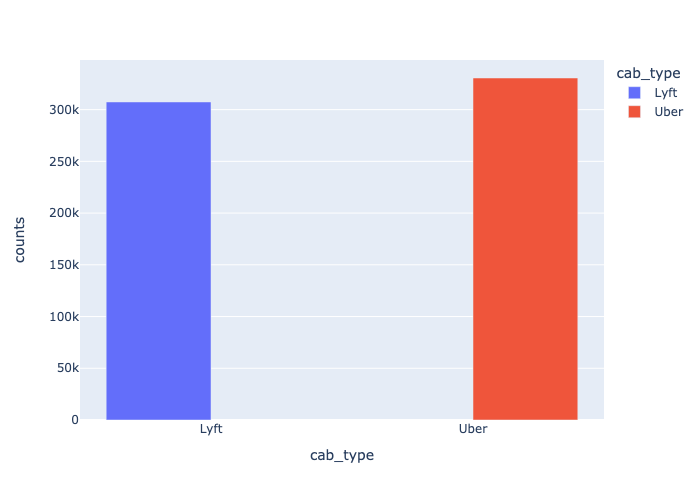

In [17]:
plot_bar('cab_type')

### So for our whole data, we have uber data more than lyft data. The difference is not too big, each cab type has about 300K data.

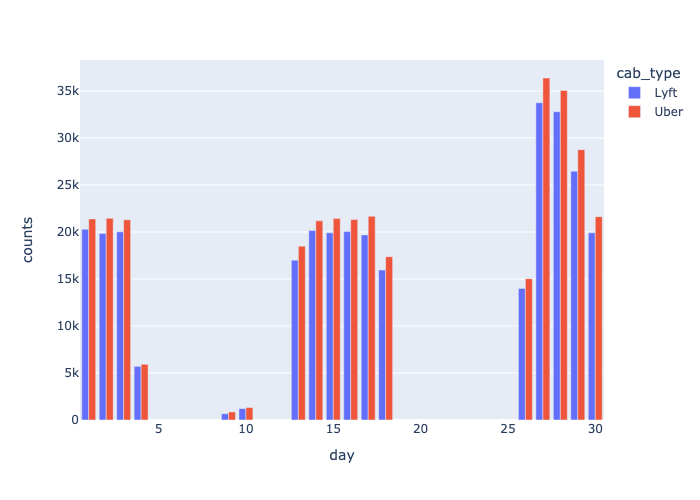

In [18]:
df2 =df.groupby(by=["day","cab_type"]).size().reset_index(name="counts")
fig2 = px.bar(data_frame=df2, x="day", y="counts", color="cab_type", barmode="group")
fig2.show(renderer='png')

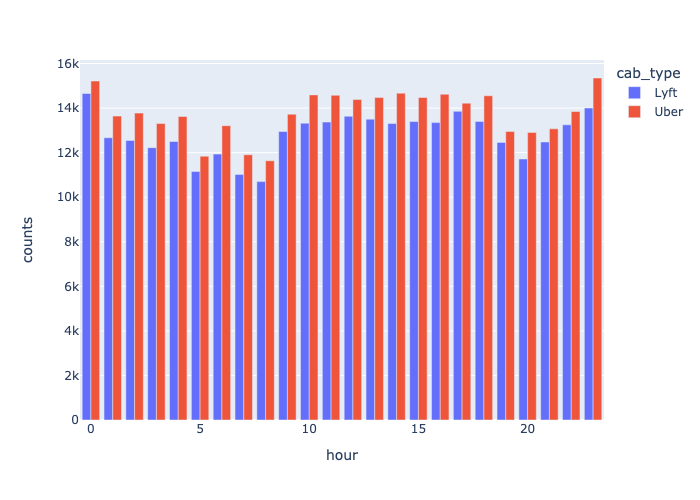

In [19]:
df3 =df.groupby(by=["hour","cab_type"]).size().reset_index(name="counts")
fig3 = px.bar(data_frame=df3, x="hour", y="counts", color="cab_type", barmode="group")
fig3.show(renderer='png')

### So in every day and every hour uber seems dominating booking order in our data

# Geospatial Visualization and Analysis

In [20]:
df.head()

,id,timestamp,hour,day,month,datetime,timezone,source,destination,cab_type,...,precipIntensityMax,uvIndexTime,temperatureMin,temperatureMinTime,temperatureMax,temperatureMaxTime,apparentTemperatureMin,apparentTemperatureMinTime,apparentTemperatureMax,apparentTemperatureMaxTime
0,424553bb-7174-41ea-aeb4-fe06d4f4b9d7,1.544953e+09,9,16,12,2018-12-16 09:30:07,America/New_York,Haymarket Square,North Station,Lyft,...,0.1276,1544979600,39.89,1545012000,43.68,1544968800,33.73,1545012000,38.07,1544958000
1,4bd23055-6827-41c6-b23b-3c491f24e74d,1.543284e+09,2,27,11,2018-11-27 02:00:23,America/New_York,Haymarket Square,North Station,Lyft,...,0.1300,1543251600,40.49,1543233600,47.30,1543251600,36.20,1543291200,43.92,1543251600
2,981a3613-77af-4620-a42a-0c0866077d1e,1.543367e+09,1,28,11,2018-11-28 01:00:22,America/New_York,Haymarket Square,North Station,Lyft,...,0.1064,1543338000,35.36,1543377600,47.55,1543320000,31.04,1543377600,44.12,1543320000
3,c2d88af2-d278-4bfd-a8d0-29ca77cc5512,1.543554e+09,4,30,11,2018-11-30 04:53:02,America/New_York,Haymarket Square,North Station,Lyft,...,0.0000,1543507200,34.67,1543550400,45.03,1543510800,30.30,1543550400,38.53,1543510800
4,e0126e1f-8ca9-4f2e-82b3-50505a09db9a,1.543463e+09,3,29,11,2018-11-29 03:49:20,America/New_York,Haymarket Square,North Station,Lyft,...,0.0001,1543420800,33.10,1543402800,42.18,1543420800,29.11,1543392000,35.75,1543420800


In [21]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 637976 entries, 0 to 637975
Data columns (total 56 columns):
 #   Column                       Non-Null Count   Dtype         
---  ------                       --------------   -----         
 0   id                           637976 non-null  object        
 1   timestamp                    637976 non-null  float64       
 2   hour                         637976 non-null  int64         
 3   day                          637976 non-null  int64         
 4   month                        637976 non-null  int64         
 5   datetime                     637976 non-null  datetime64[ns]
 6   timezone                     637976 non-null  object        
 7   source                       637976 non-null  object        
 8   destination                  637976 non-null  object        
 9   cab_type                     637976 non-null  object        
 10  product_id                   637976 non-null  object        
 11  name                      

In [22]:
df = df.drop_duplicates(subset='id')
df.shape

(637976, 56)

In [23]:
df_lat_lon = df.groupby(['source','destination']).agg({'latitude':'mean','longitude':'mean'})
df_lat_lon

latitude  longitude
source   destination                                  
Back Bay Boston University        42.337217 -71.065947
         Fenway                   42.340103 -71.065819
         Haymarket Square         42.339877 -71.066475
         North End                42.338516 -71.066170
         Northeastern University  42.338917 -71.066289
...                                     ...        ...
West End Fenway                   42.338521 -71.066339
         Haymarket Square         42.339109 -71.066251
         North End                42.338614 -71.065878
         Northeastern University  42.336812 -71.066274
         South Station            42.338753 -71.066376

[72 rows x 2 columns]

In [35]:
maps = folium.Map(location=[df["latitude"].mean(), df["longitude"].mean()],zoom_start = 11)
maps.add_child(FastMarkerCluster(df[['latitude', 'longitude']].values.tolist()))
maps

In [34]:
df_lat_lon2 = df.groupby(['destination']).agg({'latitude':'mean','longitude':'mean'})
df_lat_lon2 = df_lat_lon2.reset_index()
df_lat_lon2

,destination,latitude,longitude
0,Back Bay,42.337580,-71.065784
1,Beacon Hill,42.337563,-71.065873
2,Boston University,42.338329,-71.066277
3,Fenway,42.338248,-71.065973
4,Financial District,42.338238,-71.066248
5,Haymarket Square,42.338333,-71.066117
6,North End,42.338232,-71.066332
7,North Station,42.337757,-71.066176
8,Northeastern University,42.338445,-71.065998
9,South Station,42.338469,-71.066314


In [25]:
df_source_location = df_lat_lon2.copy()

In [26]:
df['source'].value_counts()

Financial District         54197
Back Bay                   53201
Theatre District           53201
Boston University          53172
North End                  53171
Fenway                     53166
Northeastern University    53164
South Station              53160
Haymarket Square           53147
West End                   52980
Beacon Hill                52841
North Station              52576
Name: source, dtype: int64

In [27]:
def plot_source_destination(df,df_source_location,source):
    df1 = df[df['source']==source]
    df11 = df_source_location[df_source_location['destination']==source]
    
    map1 = folium.Map(location=[df1["latitude"].mean(), df1["longitude"].mean()],zoom_start = 11)
    map1.add_child(FastMarkerCluster(df1[['latitude', 'longitude']].values.tolist(),color='green'))
    folium.Marker(location=[df11['latitude'],df11['longitude']]).add_to(map1)
    display(map1)

In [29]:
plot_source_destination(df,df_source_location,'Financial District')

In [37]:
plot_source_destination(df,df_source_location,'West End')